# Self-Driving Car Engineer Nanodegree


## Advanced Lane Finding Project

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---

## Camera Calibration

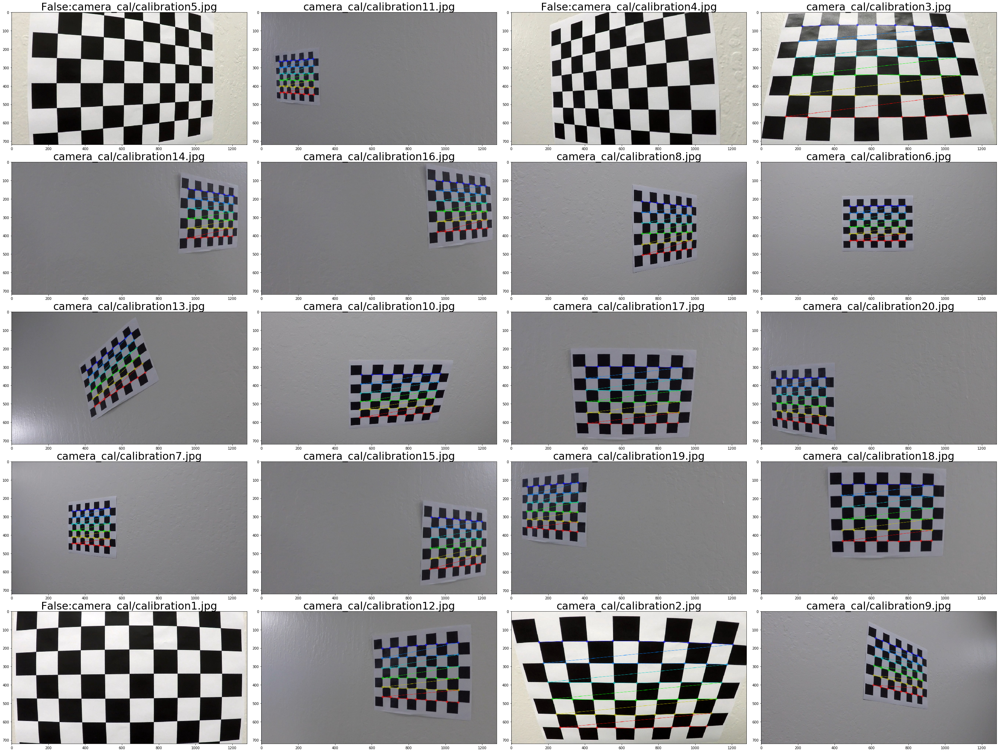

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
%matplotlib inline

#####################################################################################
def camera_calibration(nx=9, ny=6):
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((nx*ny,3), np.float32)
    objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Make a list of calibration images
    images = glob.glob('camera_cal/calibration*.jpg')

    mx=5 #4
    my=4 #5
    fig, axes = plt.subplots(mx, my, figsize=(40, 30))
    fig.tight_layout()
    im=0
    
    # Step through the list and search for chessboard corners
    for fname in images:
        #img = cv2.imread(fname)           
        #gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        img = mpimg.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
        
        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx,ny),None)

        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            imgpoints.append(corners)

            # Draw and display the corners
            img = cv2.drawChessboardCorners(img, (nx,ny), corners, ret)

            axes[im%mx,im//mx].set_title(fname, fontsize=30)
            axes[im%mx,im//mx].imshow(img)
        else:
            axes[im%mx,im//mx].set_title("False:"+fname, fontsize=30)
            axes[im%mx,im//mx].imshow(img)
        
        im = im+1 

    return cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
#####################################################################################

ret, mtx, dist, rvecs, tvecs = camera_calibration(9,6)

## Image Pipeline
### 1. Distortion Correction

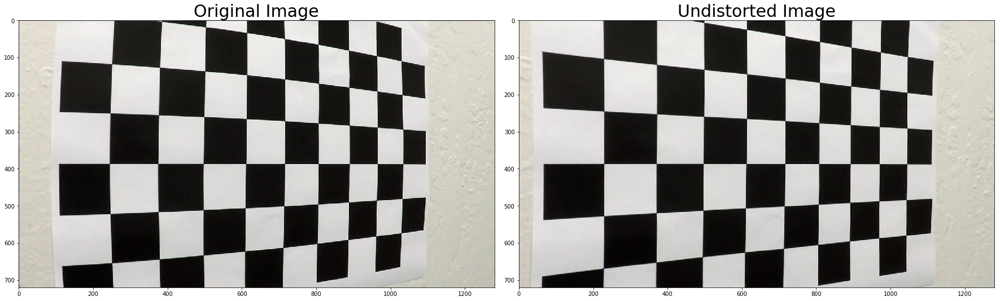

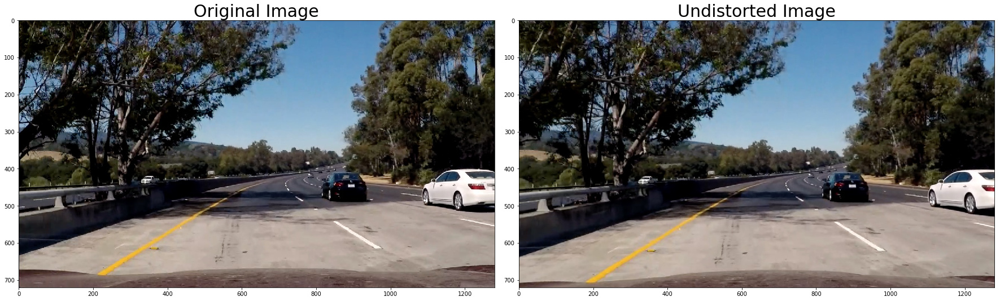

In [2]:
#####################################################################################
def img_undistort(img, mtx=None, dist=None):
    return cv2.undistort(img, mtx, dist, None, mtx)
#####################################################################################

def test_img_undistort(img, mtx=None, dist=None):
    undist=img_undistort(img, mtx, dist)
    
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(undist)
    ax2.set_title('Undistorted Image', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
#####################################################################################

img = mpimg.imread('camera_cal/calibration5.jpg')
test_img_undistort(img, mtx, dist)

img = mpimg.imread('test_images/test5.jpg')
test_img_undistort(img, mtx, dist)

### 2. Color/Gradient Threshold

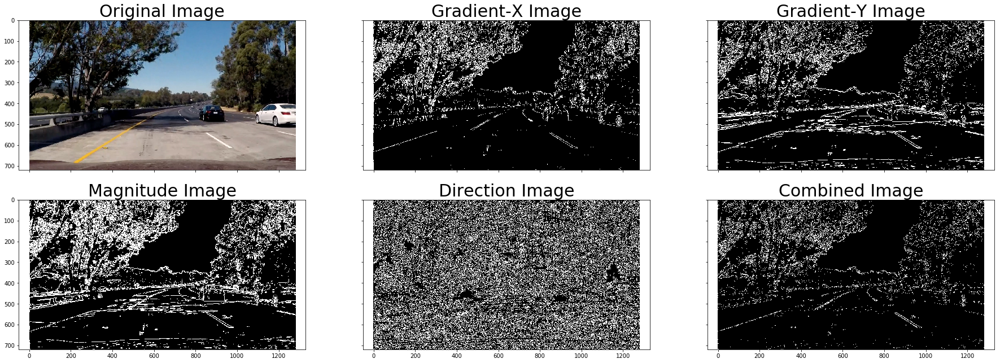

In [3]:
#####################################################################################
# Define a function that takes an image, gradient orientation,
# and threshold min / max values.
def abs_sobel_thresh(gray, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1
    
    # Sobel x
    #sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    #abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    #scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    #sxbinary = np.zeros_like(scaled_sobel)
    #sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1

    # Return the result
    return binary_output

# Define a function to return the magnitude of the gradient
# for a given sobel kernel size and threshold values
def mag_thresh(gray, sobel_kernel=3, mag_thresh=(0, 255)):
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output

# Define a function to threshold an image for a given range and Sobel kernel
def dir_threshold(gray, sobel_kernel=3, thresh=(0, np.pi/2)):
    #    gray = img
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output


def orient_threshold(gray, orient="mag",sobel_kernel=3, thresh=(0, 255)) :
    if (orient == 'x' or orient == 'y') :
        return abs_sobel_thresh(gray, orient, sobel_kernel, thresh)
    elif (orient == 'mag'):
        return mag_thresh(gray, sobel_kernel, thresh)
    else:
        return dir_threshold(gray, sobel_kernel, thresh)
    
#####################################################################################
def test_thresholds(img):
    
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    
    # Choose a Sobel kernel size
    ksize = 3 # Choose a larger odd number to smooth gradient measurements
    
    # Apply each of the thresholding functions
    gradx = orient_threshold(gray, orient='x', sobel_kernel=ksize, thresh=(20, 100))
    grady = orient_threshold(gray, orient='y', sobel_kernel=ksize, thresh=(20, 100))
    mag_binary = orient_threshold(gray, orient='mag', sobel_kernel=ksize, thresh=(20, 100))
    dir_binary = orient_threshold(gray, orient='dir', sobel_kernel=ksize, thresh=(0.7, 1.3))

    combined = np.zeros_like(dir_binary)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    
    fig, axes = plt.subplots(2, 3, sharex=True, sharey=True, figsize=(24, 9))

    axes[0,0].set_title('Original Image', fontsize=30)
    axes[0,0].imshow(img)
    axes[0,1].set_title('Gradient-X Image', fontsize=30)   
    axes[0,1].imshow(gradx, cmap='gray')
    axes[0,2].set_title('Gradient-Y Image', fontsize=30)  
    axes[0,2].imshow(grady, cmap='gray')
    axes[1,0].set_title('Magnitude Image', fontsize=30)
    axes[1,0].imshow(mag_binary, cmap='gray')
    axes[1,1].set_title('Direction Image', fontsize=30)   
    axes[1,1].imshow(dir_binary, cmap='gray')
    axes[1,2].set_title('Combined Image', fontsize=30)     
    axes[1,2].imshow(combined, cmap='gray')
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
#####################################################################################

img = mpimg.imread('test_images/test5.jpg')
test_thresholds(img)

In [4]:
def mask_white_yellow(img):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    # white color region
    lower = np.uint8([  0, 200,   0])
    upper = np.uint8([255, 255, 255])
    white_mask = cv2.inRange(hls, lower, upper)
    # yellow color region
    lower = np.uint8([ 10,   0, 100])
    upper = np.uint8([ 40, 255, 255])
    yellow_mask = cv2.inRange(hls, lower, upper)
    # combine the mask
    mask = cv2.bitwise_or(white_mask, yellow_mask)
    return cv2.bitwise_and(img, img, mask = mask)

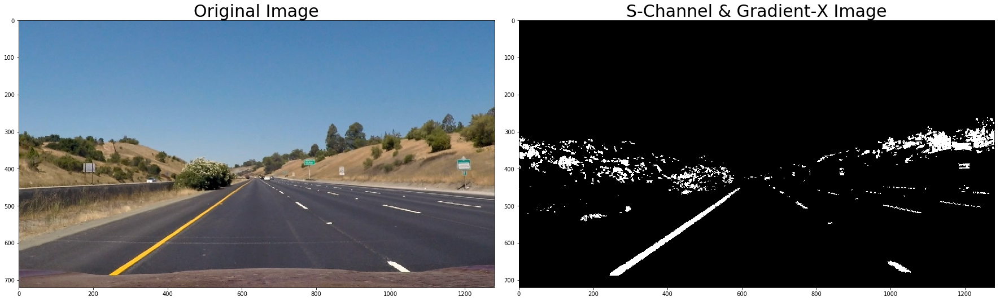

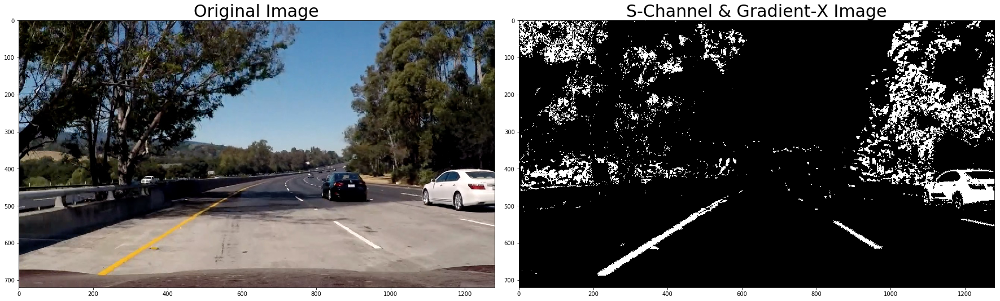

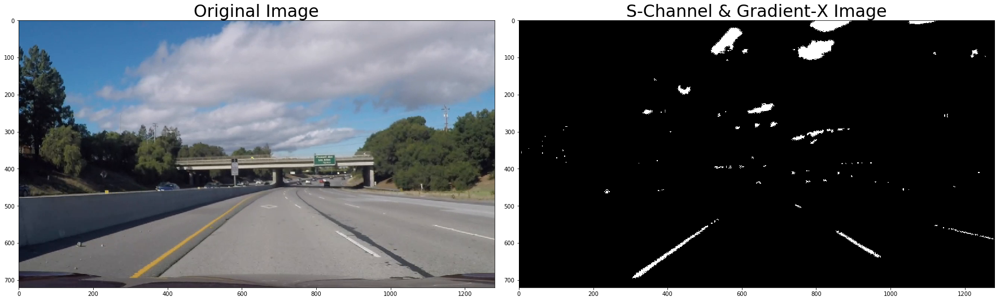

In [5]:
def hls_threshold(img, s_thresh=(170, 255), orient='x', sx_thresh=(20, 100)):

    # Mask the white and yellow colors
    yw_img=mask_white_yellow(img)
    
    #Convert the image to grayscale 
    gray = cv2.cvtColor(yw_img, cv2.COLOR_RGB2GRAY)    
    #gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)    

    # Convert to HLS color space and separate the V channel
    hls = cv2.cvtColor(yw_img, cv2.COLOR_RGB2HLS).astype(np.float)
    #l_channel = hls[:,:,1]
    s_channel = hls[:,:,2]
       
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    combined = np.zeros_like(s_channel)
    
    # Threshold x gradient
    ksize=3   
    if (orient != 'none') :
        sxbinary = orient_threshold(gray, orient, sobel_kernel=ksize, thresh=sx_thresh)
        #sxbinary = orient_threshold(l_channel, orient, sobel_kernel=ksize, thresh=sx_thresh)
        combined[((s_binary == 1)) | (sxbinary == 1)] = 1
    else:
        combined[(s_binary == 1)] = 1
        
    color_binary = combined
    
    return color_binary
#####################################################################################

def test_hls_threshold(img):
    result = hls_threshold(img, s_thresh=(5, 255), orient="x", sx_thresh=(20, 100))

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)

    ax2.imshow(result, cmap='gray')
    ax2.set_title('S-Channel & Gradient-X Image', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
#####################################################################################
img = mpimg.imread('test_images/straight_lines1.jpg')
test_hls_threshold(img)

img = mpimg.imread('test_images/test5.jpg')
test_hls_threshold(img)

img = mpimg.imread('tmp-1.jpg')
test_hls_threshold(img)

### 3.  Perspective Transform

[[  585.           460.        ]
 [  203.33332825   720.        ]
 [ 1126.66662598   720.        ]
 [  695.           460.        ]]
[[ 320.    0.]
 [ 320.  720.]
 [ 960.  720.]
 [ 960.    0.]]


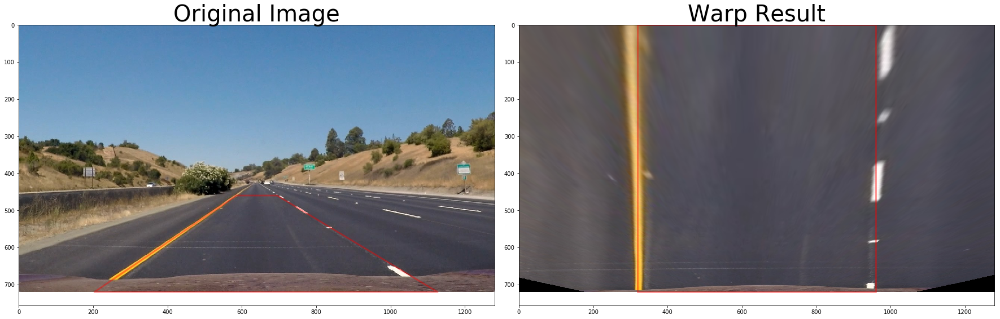

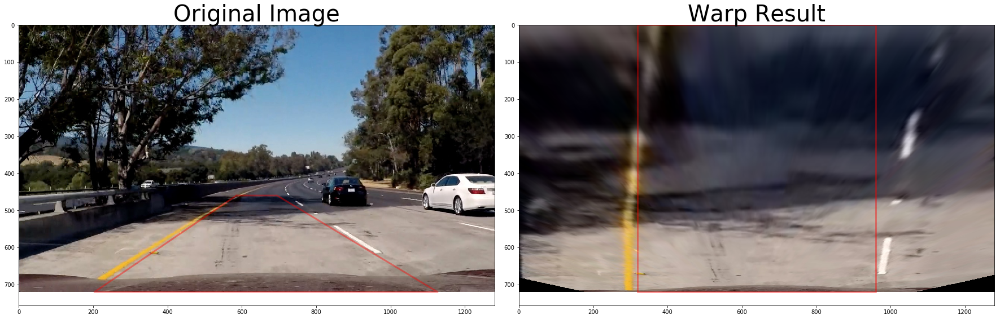

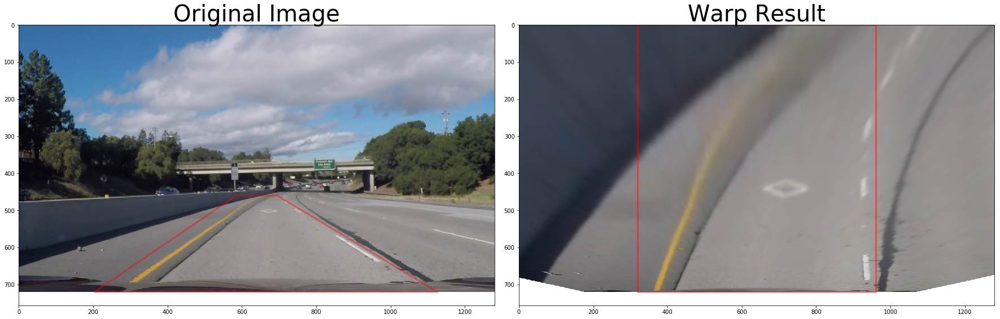

In [6]:
# Define calibration box in source(original) and destination (desired or warped)
img_size = (1280,720)
src = np.float32(
    [[(img_size[0] / 2) - 55, img_size[1] / 2 + 100],
    [((img_size[0] / 6) - 10), img_size[1]],
    [(img_size[0] * 5 / 6) + 60, img_size[1]],
    [(img_size[0] / 2 + 55), img_size[1] / 2 + 100]])
dst = np.float32(
    [[(img_size[0] / 4), 0],
    [(img_size[0] / 4), img_size[1]],
    [(img_size[0] * 3 / 4), img_size[1]],
    [(img_size[0] * 3 / 4), 0]])

print(src)
print(dst)

# Compute the perspective transform, M
M = cv2.getPerspectiveTransform(src, dst)

# Compute the inverse perspective transfrom Minv
Minv = cv2.getPerspectiveTransform(dst, src)

##############################################################################
# Define perspective tranform function
def warper(img):
    img_size = (img.shape[1], img.shape[0])
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)    
    return warped
##############################################################################

def test_warper(img): 
    result = warper(img)
    
    undist=img_undistort(img, mtx, dist)
    result = warper(undist)

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=40)

    x = [src[0][0],src[1][0],src[2][0],src[3][0],src[0][0]]
    y = [src[0][1],src[1][1],src[2][1],src[3][1],src[0][1]]
    ax1.plot(x, y, color='red', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)

    ax2.imshow(result, cmap='gray')
    ax2.set_title('Warp Result', fontsize=40)
    x = [dst[0][0],dst[1][0],dst[2][0],dst[3][0],dst[0][0]]
    y = [dst[0][1],dst[1][1],dst[2][1],dst[3][1],dst[0][1]]
    ax2.plot(x, y, color='red', alpha=0.4, linewidth=3, solid_capstyle='round', zorder=2)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

##############################################################################
img = mpimg.imread('test_images/straight_lines1.jpg')
test_warper(img)

img = mpimg.imread('test_images/test5.jpg')
test_warper(img)

img = mpimg.imread('tmp-1.jpg')
test_warper(img)

### 4. Lane Dectection


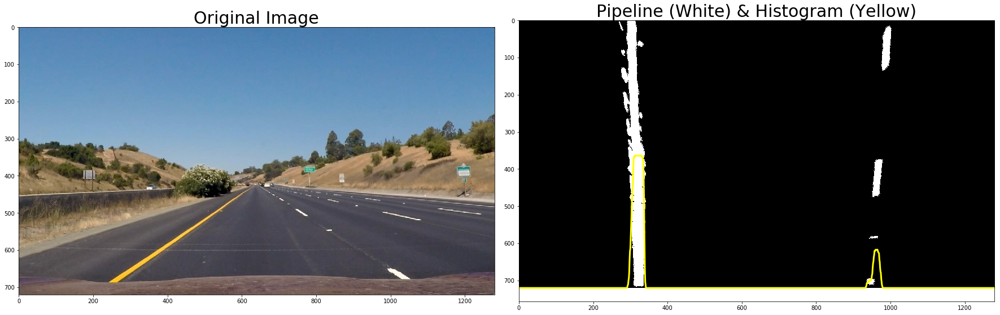

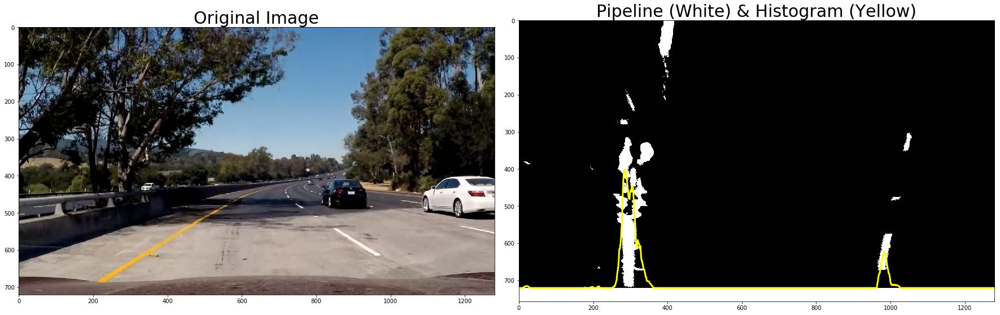

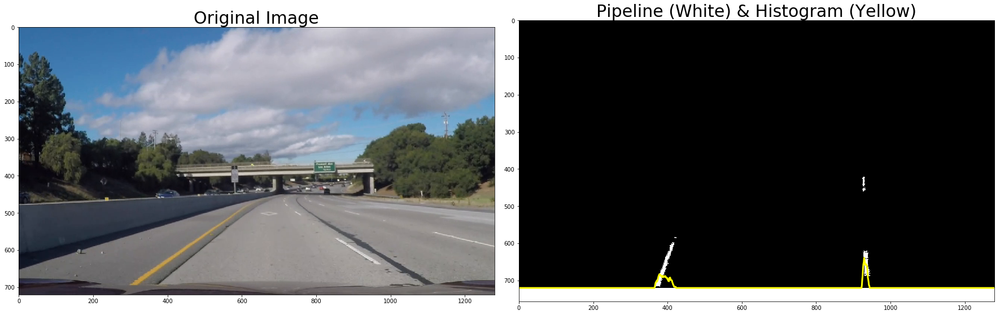

In [7]:
#####################################################################
def pipeline(undist):
        
    warped  =warper(undist)
    hls_binary = hls_threshold(warped, s_thresh=(5, 255), orient="x", sx_thresh=(20, 100))
    
    return hls_binary
#####################################################################

def test_pipeline(img):
    undist=img_undistort(img, mtx, dist)
    result=pipeline(undist)

    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)

    ax2.imshow(result, cmap='gray')
    ax2.set_title('Pipeline (White) & Histogram (Yellow)', fontsize=30)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    
    histogram = np.sum(result[result.shape[0]//2:,:], axis=0)
    histogram = result.shape[0]-histogram
    ax2.plot(histogram, color='yellow', linewidth=3)
###################################################################################
    
img = mpimg.imread('test_images/straight_lines1.jpg')
test_pipeline(img)

img = mpimg.imread('test_images/test5.jpg')
test_pipeline(img)

img = mpimg.imread('tmp-1.jpg')
test_pipeline(img)

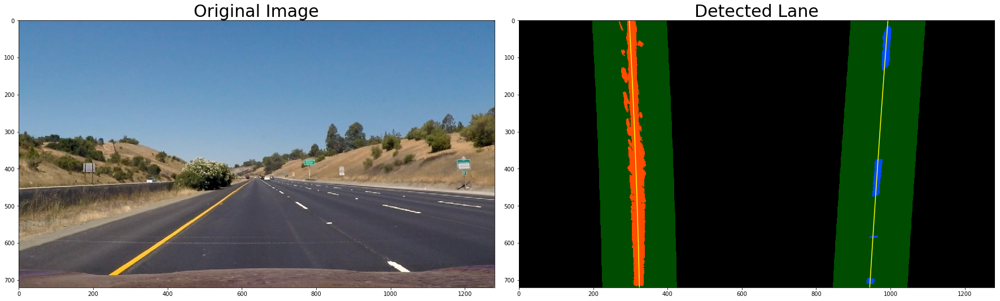

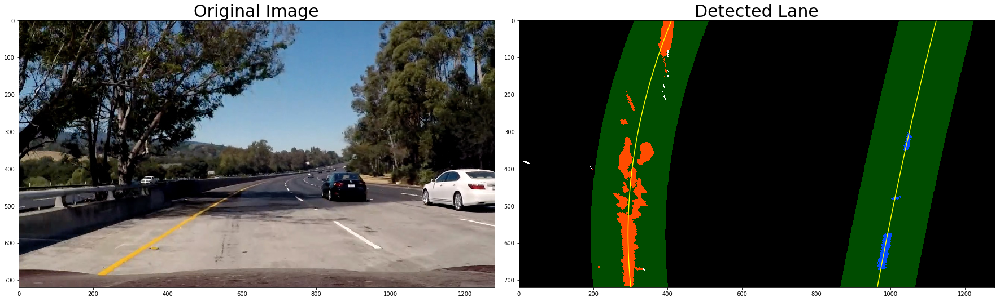

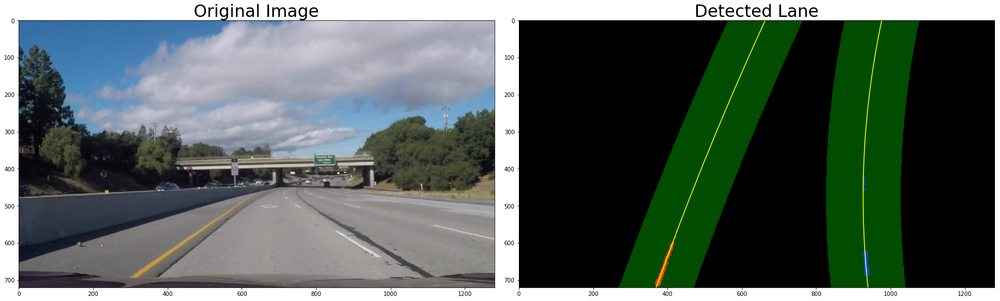

In [8]:
def cal_leftright_coefs(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    # ///out_img =  np.uint8(np.dstack((binary_warped, binary_warped, binary_warped))*255)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]//2)
    ww=histogram.shape[0]
    leftx_base = np.argmax(histogram[50:midpoint])
    rightx_base = np.argmax(histogram[midpoint:(ww-50)]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        #///cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        #///cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    if (len(leftx) > 1) :
        left_fit = np.polyfit(lefty, leftx, 2)
    else:
        left_fit = (0,0,0)
    if (len(rightx) > 1) :
        right_fit = np.polyfit(righty, rightx, 2)
    else:
        right_fit = (0,0,0)

    return leftx, lefty, rightx, righty, left_fit, right_fit

#####################################################################
def test_cal_leftright_coefs(img):
    undist=img_undistort(img, mtx, dist)
    binary_warped=pipeline(undist)

    leftx, lefty, rightx, righty, left_fit, right_fit = cal_leftright_coefs(binary_warped)
    
    # Plot the result
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    out_img=np.uint8(np.dstack((binary_warped, binary_warped, binary_warped))*255)
    out_img[lefty, leftx]   = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    plt.imshow(out_img)
    plt.plot(left_fitx, ploty, color='yellow')
    plt.plot(right_fitx, ploty, color='yellow')
    plt.xlim(0, 1280)
    plt.ylim(720, 0)
    
#####################################################################
def testA_cal_leftright_coefs(img):
    
    undist=img_undistort(img, mtx, dist)
    binary_warped=pipeline(undist)

    margin = 100
    
    leftx, lefty, rightx, righty, left_fit, right_fit = cal_leftright_coefs(binary_warped)

    # Create an image to draw on and an image to show the selection window
    out_img = np.uint8(np.dstack((binary_warped, binary_warped, binary_warped))*255)
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[lefty, leftx]   = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()

    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)

    ax2.imshow(result, cmap='gray')
    ax2.set_title('Detected Lane', fontsize=30)
    ax2.plot(left_fitx, ploty, color='yellow')
    ax2.plot(right_fitx, ploty, color='yellow')
        
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

######################################################################################    
img = mpimg.imread('test_images/straight_lines1.jpg')
testA_cal_leftright_coefs(img)
img = mpimg.imread('test_images/test5.jpg')
testA_cal_leftright_coefs(img)
img = mpimg.imread('tmp-1.jpg')
testA_cal_leftright_coefs(img)

### 5. Lane Curvature Determination



In [9]:
def cal_curveRad(img, leftx, lefty, rightx, righty, left_fit, right_fit):
    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    curveRad = 0
    offset = 0 
    
    if ((len(leftx)>1) & (len(rightx)>1)):

        y_eval = np.max(lefty)
    
        # Fit new polynomials to x,y in world space
        if (len(leftx)>1):
            left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
        else:
            left_fit_cr = (0,0,0)
        if (len(rightx)>1):
            right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
        else:
            right_fit_cr = (0,0,0)
    
        # Calculate the new radii of curvature
        left_curverad = ((1 + (2*left_fit_cr[0]*y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
        right_curverad = ((1 + (2*right_fit_cr[0]*y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
        # Now our radius of curvature is in meters
        curveRad=0.5*(left_curverad+right_curverad)
        #print("Curve Radius:", curveRad,"m")
        #print(left_curverad, 'm', right_curverad, 'm')
    
        car_center = img.shape[1]/2
        ploty = img.shape[0]
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        lane_center = 0.5*(left_fitx + right_fitx )
        offset = (car_center-lane_center) * xm_per_pix 
    
    #print("Offset:",offset, 'm')
    return curveRad, offset 
    # Example values: 632.1 m    626.2 m
###################################################################################### 

#img = mpimg.imread('test_images/test2.jpg')
#cal_curveRad(img)

### 6. Warp the detected lane boundaries back onto the original image

In here, the lane boundaries and numerical estimation are displayed.

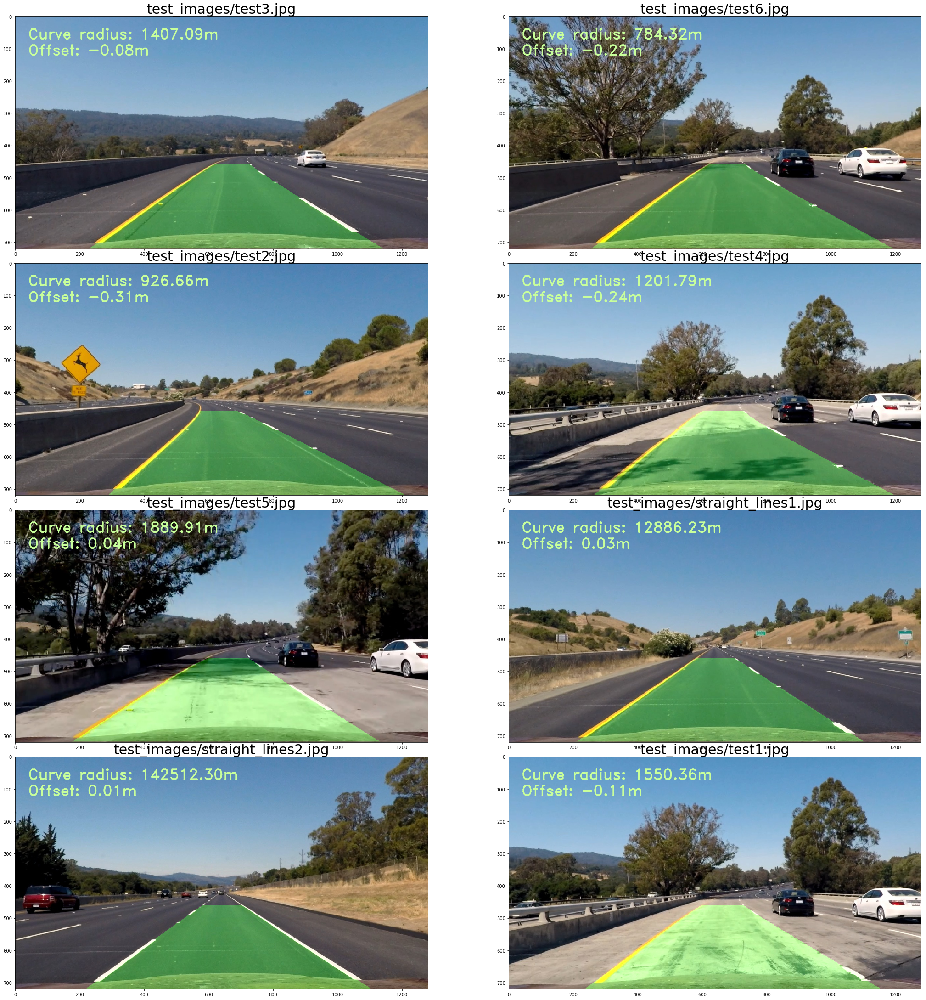

In [10]:
def draw_detectedLane(img):
    undist=img_undistort(img, mtx, dist)
    warped=pipeline(undist)

    leftx, lefty, rightx, righty, left_fit, right_fit = cal_leftright_coefs(warped)

    # Generate x and y values for plotting
    ploty = np.linspace(0, warped.shape[0]-1, warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
    # Combine the result with the original image
    result = cv2.addWeighted(undist, 1, newwarp, 0.3, 0)
    
    curveRad, offset = cal_curveRad(result, leftx, lefty, rightx, righty, left_fit, right_fit)
    new_img = np.copy(result)
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.2f}'.format(curveRad) + 'm'
    cv2.putText(new_img, text, (40,70), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    text = 'Offset: ' + '{:04.2f}'.format(offset) + 'm '
    cv2.putText(new_img, text, (40,120), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
       
    #plt.imshow(new_img)
    return new_img
#################################################################################################

def test_draw_detectedLane():
    images = glob.glob('test_images/*.jpg')
    mx=4
    my=2
    #fig, axes = plt.subplots(mx, my, sharex=True, sharey=True, figsize=(48, 18))
    fig, axes = plt.subplots(mx, my, figsize=(30,30))
    fig.tight_layout()
    im=0   
    for fname in images:
        img = mpimg.imread(fname)
        new_img = draw_detectedLane(img)
        axes[im%mx,im//mx].set_title(fname, fontsize=30)
        axes[im%mx,im//mx].imshow(new_img)  
        im = im+1 
        
test_draw_detectedLane()

## Video Results

### 1. Project Video

In [11]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

def process_image(image):
    #plt.imsave("tmp-3.jpg",image)
    result = draw_detectedLane(image)
    #plt.imshow(result)
    return result

In [12]:
video_input  = 'project_video.mp4'
video_output = 'project_video_output.mp4'

clip2 = VideoFileClip(video_input) #.subclip(23.5,23.5)
img_clip = clip2.fl_image(process_image)
%time img_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [02:20<00:00,  8.56it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 10min 20s, sys: 7.68 s, total: 10min 27s
Wall time: 2min 20s


In [13]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

### 2. Challenge Video

In [14]:
video_input  = 'challenge_video.mp4'
video_output = 'challenge_video_output.mp4'

clip2 = VideoFileClip(video_input) #.subclip(0,2)
img_clip = clip2.fl_image(process_image)
%time img_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|██████████| 485/485 [00:48<00:00,  8.35it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

CPU times: user 3min 44s, sys: 2.16 s, total: 3min 46s
Wall time: 49.3 s


In [15]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

### 3. Harder Challenge Video

In [16]:
video_input  = 'harder_challenge_video.mp4'
video_output = 'harder_challenge_video_output.mp4'

clip2 = VideoFileClip(video_input) #.subclip(0,2)
img_clip = clip2.fl_image(process_image)
%time img_clip.write_videofile(video_output, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [02:41<00:00,  8.36it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

CPU times: user 11min 46s, sys: 5.46 s, total: 11min 51s
Wall time: 2min 42s


In [17]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output))

## Discussion

  Noted that, the "`Challenge Video`" and "`Harder Challenge Video`" should be improved more in the further study.